In [1]:

%pylab inline

Populating the interactive namespace from numpy and matplotlib


In [2]:
%pylab inline
import os.path as op
import sys
import os

import json

Populating the interactive namespace from numpy and matplotlib


## Import openslide

In [3]:
pth = op.expanduser(r"~\Downloads\openslide\openslide-win64\bin")
# pth = op.expanduser(r"~\projects\scaffan\devel\knihovny")
# pth = op.expanduser(r"~\Miniconda3\envs\lisa36\Library\bin")
sys.path.insert(0, pth)
orig_PATH = os.environ["PATH"]
os.environ["PATH"] = pth + ";" + os.environ["PATH"]

In [4]:
# import numpy as np
import openslide as opsl

## Import lxml 

Doesnt work :-( #TODO

In [36]:

# os.environ["PATH"] = orig_PATH

In [37]:
#import lxml
#from lxml import etree


In [38]:
# dir(lxml)
# from lxml import etree 

# annotation_file = "e:data/scaffold/Hamamatsu/PIG-003_J-18-0165_HE.ndpi.ndpa"
# etree.parse(annotation_file)

In [39]:
# import lxml.etree

# Work with image data

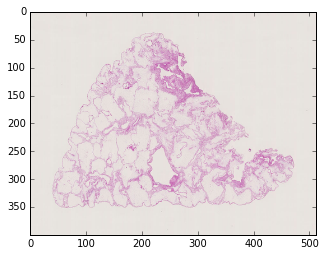

In [5]:
pth = r"E:\data\scaffold\Hamamatsu\PIG-003_J-18-0165_HE.ndpi"
imsl = opsl.OpenSlide(pth)
imthumb = imsl.get_thumbnail((512, 512))

plt.imshow(imthumb)

In [41]:
imsl.level_count

9

In [42]:
imsl.level_dimensions

((57344, 44800),
 (28672, 22400),
 (14336, 11200),
 (7168, 5600),
 (3584, 2800),
 (1792, 1400),
 (896, 700),
 (448, 350),
 (224, 175))

In [43]:
imsl.level_downsamples

(1.0, 2.0, 4.0, 8.0, 16.0, 32.0, 64.0, 128.0, 256.0)

In [44]:
pm = imsl.properties
list(pm.keys())

['hamamatsu.AHEX[0]',
 'hamamatsu.AHEX[0].fluorescence',
 'hamamatsu.AHEX[0].ploidy',
 'hamamatsu.AHEX[1]',
 'hamamatsu.AHEX[1].fluorescence',
 'hamamatsu.AHEX[1].ploidy',
 'hamamatsu.AHEX[2]',
 'hamamatsu.AHEX[2].fluorescence',
 'hamamatsu.AHEX[2].ploidy',
 'hamamatsu.Created',
 'hamamatsu.MHLN[0].24bit',
 'hamamatsu.MHLN[0].36bit',
 'hamamatsu.MHLN[1].24bit',
 'hamamatsu.MHLN[1].36bit',
 'hamamatsu.MHLN[2].24bit',
 'hamamatsu.MHLN[2].36bit',
 'hamamatsu.Macro.S/N',
 'hamamatsu.NDP.S/N',
 'hamamatsu.Objective.Lens.Magnificant',
 'hamamatsu.PSHV',
 'hamamatsu.PSHV.10x',
 'hamamatsu.PSHV.40x',
 'hamamatsu.PSHV.ploidy',
 'hamamatsu.PSHV.ploidy.10x',
 'hamamatsu.Product',
 'hamamatsu.Reference',
 'hamamatsu.SourceLens',
 'hamamatsu.Updated',
 'hamamatsu.XOffsetFromSlideCentre',
 'hamamatsu.YOffsetFromSlideCentre',
 'hamamatsu.YRNP[0]',
 'hamamatsu.YRNP[1]',
 'hamamatsu.YRNP[2]',
 'hamamatsu.calibration.version',
 'hamamatsu.ccd.height',
 'hamamatsu.ccd.width',
 'hamamatsu.ccd.width.ploidy

In [45]:
list(pm.items())

[('hamamatsu.AHEX[0]',
  '70261846BD036C2A1849BC016C211C44B80468191837B909681D143BB10264160C36B50B60261041B00C5C270446B00A5C190435B10364160C3AB000602B0C4CB00C641D1043B50368151839B80268141438B8066C161C3FB40C6C14203BB800E819'),
 ('hamamatsu.AHEX[0].fluorescence',
  '000700000023000300000027010B0000002B01170000001B010F0000001F011B00000017010F0000003301130000002F01230000001F012300000023010F0000002F012700000023012B00000023012F00000027012B0000002F01270000002711FC'),
 ('hamamatsu.AHEX[0].ploidy',
  '7C21183FB1097823183FB10778191C3FB103740F1C2FB10F74131433A907700F0C2FA90F6C1F103BA809681F043FA807680F042FA907700B0C33A9036C210C47A80B7011103FAD03740B1833B00074071433B003740B1C3BAC0B78072437B0002232'),
 ('hamamatsu.AHEX[1]',
  '7C282446C001742C244BC00574202844C007701C2439C108741E203BB80170181834B90868281C40B80E64291045B40C641C1036B9026C181839B803682F184CB80F6C1E1C43B80074192437BC0470182035BC09741A2840BC0E74182C3CBC05954F'),
 ('hamamatsu.AHEX[1].fluorescence',
  '000000000027000000000027010F0000002B0

## Resolution

In [46]:
resolution_unit = pm.get("tiff.ResolutionUnit")
resolution_x= pm.get("tiff.XResolution")
resolution_y= pm.get("tiff.YResolution")
print("Resolution {}x{} pixels/{}".format(resolution_x, resolution_y, resolution_unit))

Resolution 44005x43953 pixels/centimeter


In [47]:
imsl.dimensions

(57344, 44800)

In [48]:
# my annotataion area
kwargs_annotation_area = dict(
    location = (19000, 10000),
    level = 4,
    size = (1200, 900),
)

In [49]:
# one lobulus
kwargs_one_lobulus = dict(
    location = (19000, 10000),
    level = 4,
    size = (400, 400),
)

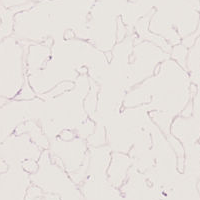

In [50]:
# one lobulus
kwargs_sample0 = dict(
    location = (10500, 21000),
    level = 2,
    size = (200, 200),
)
imsl.read_region(**kwargs_sample0)

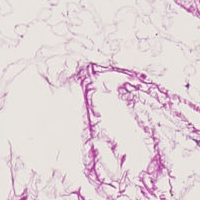

In [51]:
# one lobulus
kwargs_sample1 = dict(
    location = (13000, 15000),
    level = 2,
    size = (200, 200),
)
imsl.read_region(**kwargs_sample1)

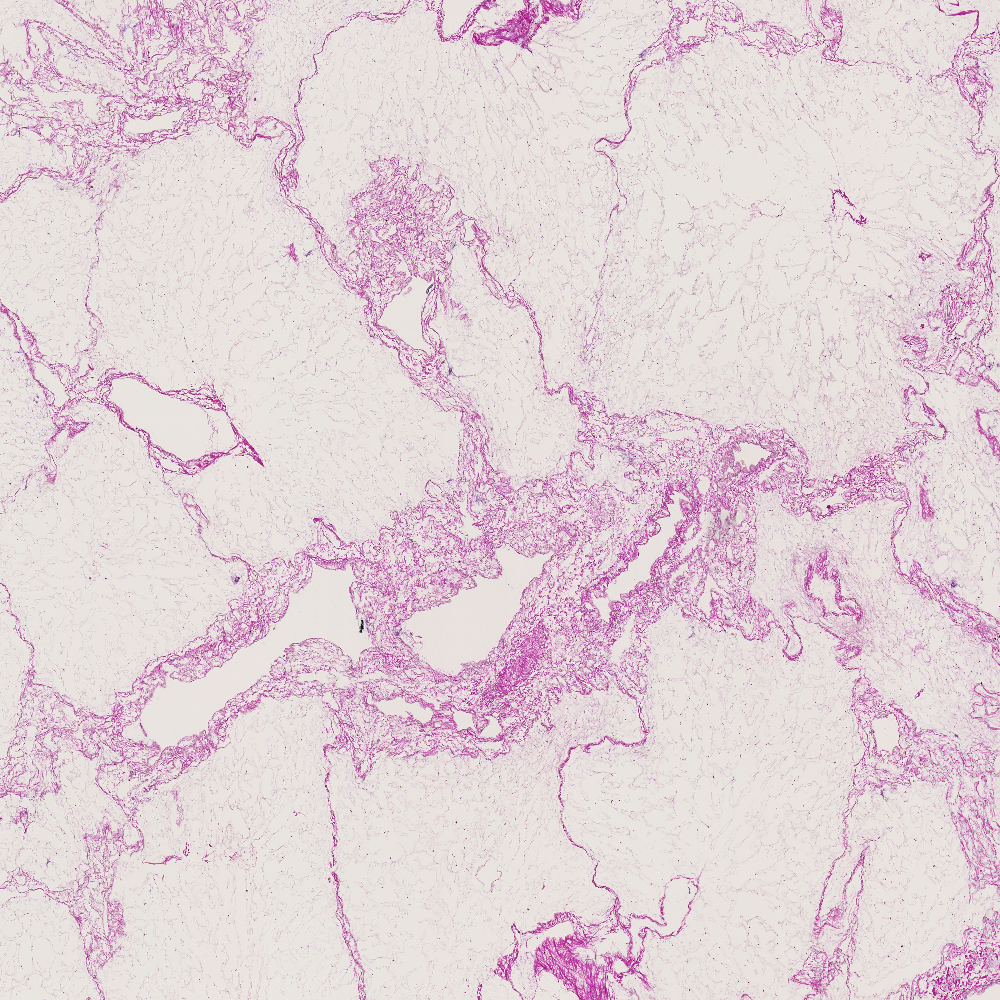

In [52]:
# one lobulus
kwargs_sample_bigger = dict(
    location = (13000, 15000),
    level = 2,
    size = (3200, 3200),
)
imsl.read_region(**kwargs_sample_bigger)

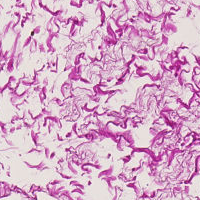

In [53]:
# one lobulus
kwargs_sample2 = dict(
    location = (26000, 15000),
    level = 2,
    size = (200, 200),
)
imsl.read_region(**kwargs_sample2)

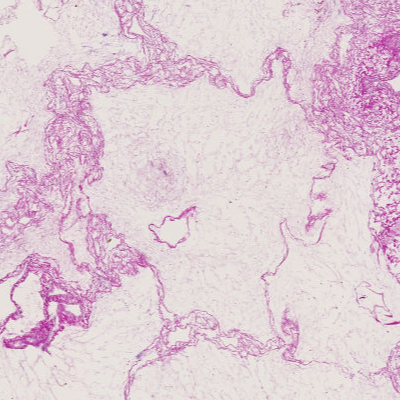

In [54]:
imcr = imsl.read_region(**kwargs_one_lobulus)
imcr

In [55]:
im = np.asarray(imcr)

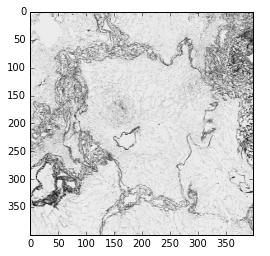

In [56]:
import skimage
import skimage.color
import skimage.filters
imgr = skimage.color.rgb2gray(im)
imshow(imgr, cmap='gray')

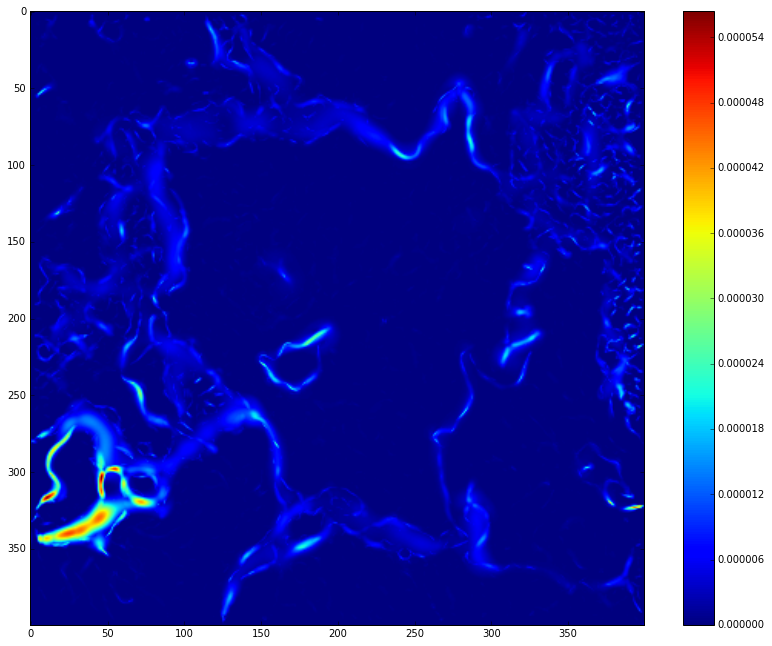

In [57]:
imgr_frangi = skimage.filters.frangi(imgr)
plt.figure(figsize=(14,11))
imshow(imgr_frangi)
colorbar()

In [58]:
def circle_level_set(shape, center, sqradius, scalerow=1.0):
    """Build a binary function with a circle as the 0.5-levelset."""
    grid = np.mgrid[list(map(slice, shape))].T - center
    phi = sqradius - np.sqrt(np.sum((grid.T)**2, 0))
    u = np.float_(phi > 0)
    return u

C:\Users\miros\Miniconda3\envs\lisa36\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.minimum.reduce will be axis=0, not the current None, to match np.minimum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)
C:\Users\miros\Miniconda3\envs\lisa36\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.maximum.reduce will be axis=0, not the current None, to match np.maximum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)


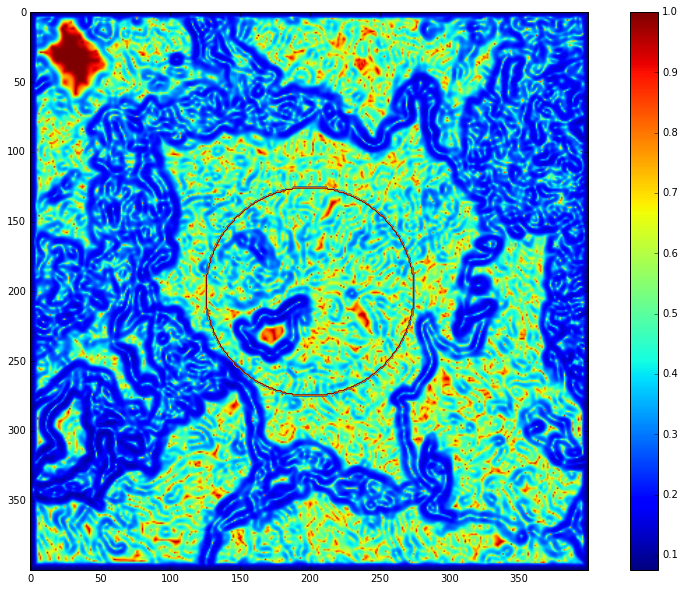

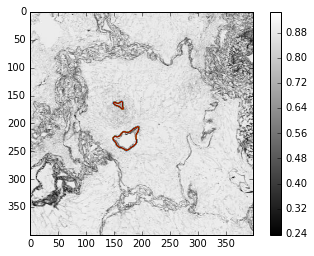

In [59]:

import morphsnakes as ms
#     logging.info('Running: example_starfish (MorphGAC)...')
    
    # Load the image.
#     imgcolor = imread(PATH_IMG_STARFISH) / 255.0
#     img = rgb2gray(imgcolor)
    
    # g(I)
# gimg = ms.inverse_gaussian_gradient(imgr_frangi, alpha=1000, sigma=2)
    
# Initialization of the level-set.
# init_ls = circle_level_set(imgr_frangi.shape, (200, 200), 85)

# Callback for visual plotting
# callback = ms.visual_callback_2d(imgcolor)
gb = ms.gborders(imgr_frangi, alpha=1000, sigma=2)
gb = ms.gborders(imgr, alpha=1000, sigma=2)
mgac = ms.MorphGAC(gb, smoothing=2, threshold=0.3, balloon=-1)

mgac.levelset = circle_level_set(imgr_frangi.shape, (200, 200), 75, scalerow=0.75)
plt.figure(figsize=(15,10))
plt.imshow(gb)
plt.colorbar()
plt.contour(mgac.levelset)
mgac.run(iterations=110)
plt.figure()
plt.imshow(imgr, cmap="gray")
plt.colorbar()
plt.contour(mgac.levelset)
inner = mgac.levelset
# ms.evolve(mgac, num_iters=110, background=imgr)

# # MorphGAC. 
# ms.MorphGAC(imgr_frangi, iterations=100, 
#                                          init_level_set=init_ls,
#                                          smoothing=2, threshold=0.3,
#                                          balloon=-1)#, iter_callback=callback)

C:\Users\miros\Miniconda3\envs\lisa36\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.minimum.reduce will be axis=0, not the current None, to match np.minimum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)
C:\Users\miros\Miniconda3\envs\lisa36\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.maximum.reduce will be axis=0, not the current None, to match np.maximum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)


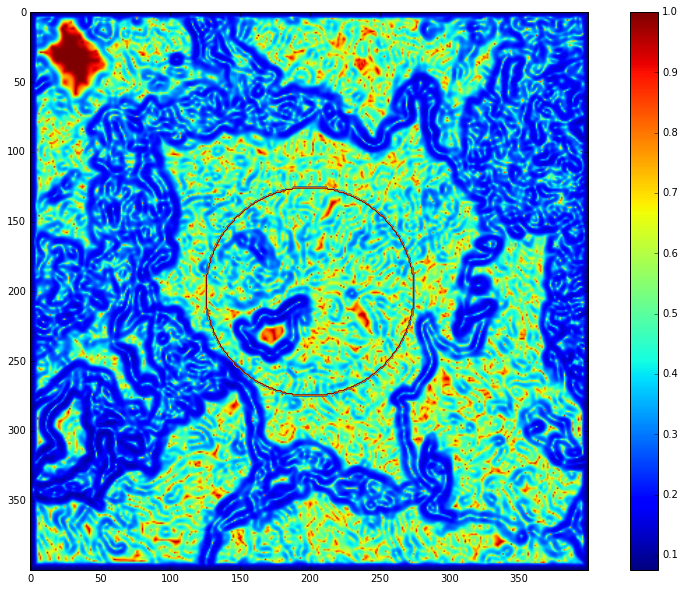

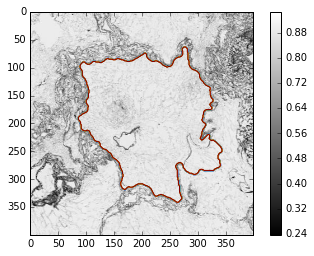

In [60]:

import morphsnakes as ms
#     logging.info('Running: example_starfish (MorphGAC)...')
    
    # Load the image.
#     imgcolor = imread(PATH_IMG_STARFISH) / 255.0
#     img = rgb2gray(imgcolor)
    
    # g(I)
# gimg = ms.inverse_gaussian_gradient(imgr_frangi, alpha=1000, sigma=2)
    
# Initialization of the level-set.
# init_ls = circle_level_set(imgr_frangi.shape, (200, 200), 85)

# Callback for visual plotting
# callback = ms.visual_callback_2d(imgcolor)
gb = ms.gborders(imgr_frangi, alpha=1000, sigma=2)
gb = ms.gborders(imgr, alpha=1000, sigma=2)
mgac = ms.MorphGAC(gb, smoothing=2, threshold=0.3, balloon=+1)

mgac.levelset = circle_level_set(imgr_frangi.shape, (200, 200), 75, scalerow=0.75)
plt.figure(figsize=(15,10))
plt.imshow(gb)
plt.colorbar()
plt.contour(mgac.levelset)
mgac.run(iterations=110)
plt.figure()
plt.imshow(imgr, cmap="gray")
plt.colorbar()
plt.contour(mgac.levelset)
outer = mgac.levelset
# ms.evolve(mgac, num_iters=110, background=imgr)

# # MorphGAC. 
# ms.MorphGAC(imgr_frangi, iterations=100, 
#                                          init_level_set=init_ls,
#                                          smoothing=2, threshold=0.3,
#                                          balloon=-1)#, iter_callback=callback)

# Lobulus area analysis

C:\Users\miros\Miniconda3\envs\lisa36\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.minimum.reduce will be axis=0, not the current None, to match np.minimum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)
C:\Users\miros\Miniconda3\envs\lisa36\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.maximum.reduce will be axis=0, not the current None, to match np.maximum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)


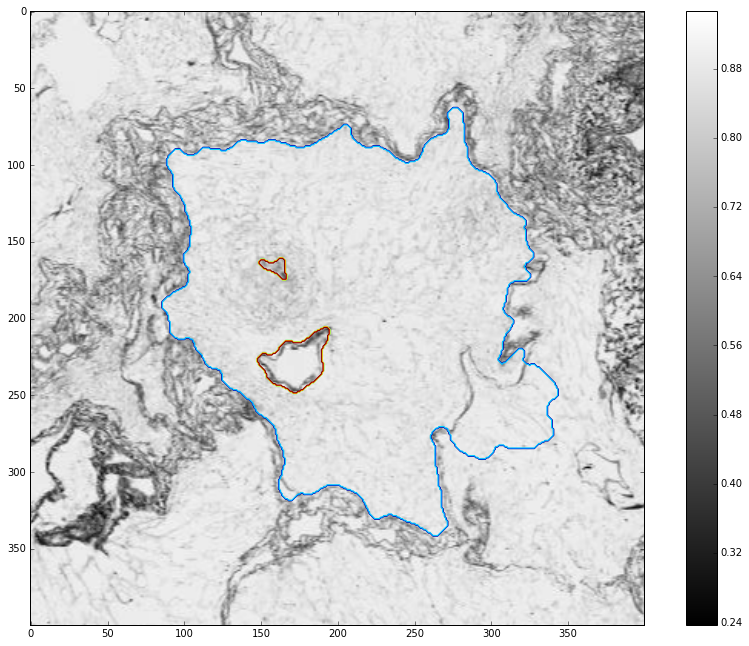

In [61]:
lobulus = inner + outer

plt.figure(figsize=(15,11))
plt.imshow(imgr, cmap="gray")
plt.colorbar()
plt.contour(lobulus)


## Transfer segmentation to different level

In [62]:
new_level = int(1)
location = kwargs_one_lobulus["location"]
former_level = kwargs_one_lobulus["level"]
former_size = kwargs_one_lobulus["size"]


imsl.level_downsamples

scale_factor = imsl.level_downsamples[former_level] / imsl.level_downsamples[new_level]
new_size = (np.asarray(former_size) * scale_factor).astype(np.int)




In [63]:
newimcr = imsl.read_region(location, new_level, new_size)

new_lobulus = skimage.transform.resize(lobulus, new_size, mode="reflect")

C:\Users\miros\Miniconda3\envs\lisa36\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.minimum.reduce will be axis=0, not the current None, to match np.minimum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)
C:\Users\miros\Miniconda3\envs\lisa36\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.maximum.reduce will be axis=0, not the current None, to match np.maximum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)


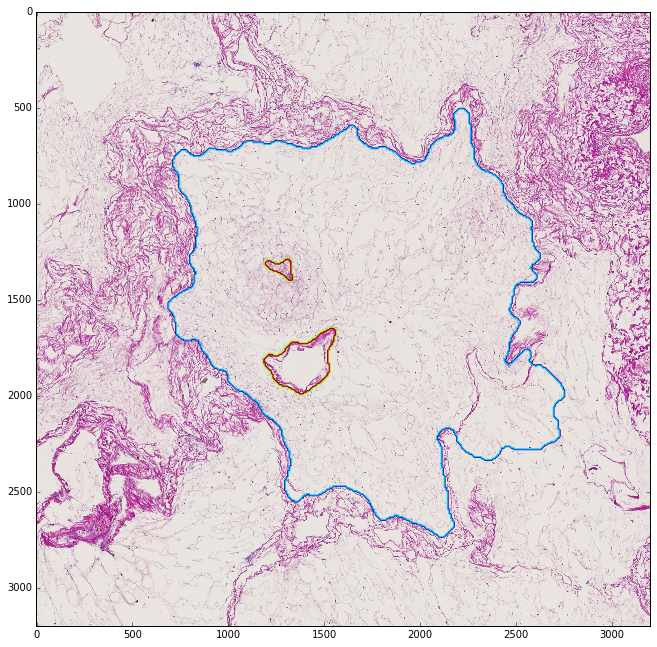

In [64]:

plt.figure(figsize=(15,11))
plt.imshow(newimcr)
# plt.colorbar()
plt.contour(new_lobulus)

## Binarization

(3200, 3200)

(3200, 3200)

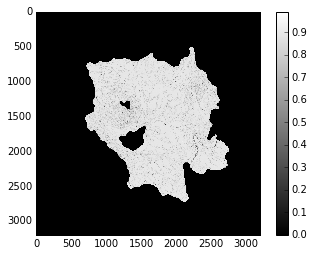

In [65]:

newimgr = skimage.color.rgb2gray(np.array(newimcr))
display(newimgr.shape)
display(new_lobulus.shape)
lobulus_area = newimgr.copy()
lobulus_area[new_lobulus!=1] = 0
plt.imshow(lobulus_area, cmap='gray')
plt.colorbar()

(array([  1.31000000e+02,   1.14300000e+03,   2.77900000e+03,
          4.30900000e+03,   7.45600000e+03,   1.79650000e+04,
          6.19340000e+04,   2.34675000e+05,   2.32902000e+06,
          9.85400000e+04]),
 array([ 0.11575373,  0.20330624,  0.29085875,  0.37841125,  0.46596376,
         0.55351627,  0.64106878,  0.72862129,  0.8161738 ,  0.90372631,
         0.99127882]),
 <a list of 10 Patch objects>)

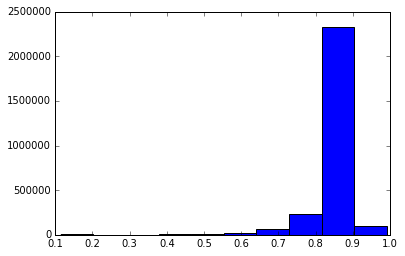

In [66]:
plt.hist(newimgr[new_lobulus==1])

In [67]:
threshold = skimage.filters.threshold_otsu(newimgr[new_lobulus==1])
threshold

0.80146771829044117

In [68]:
thrdata = newimgr[new_lobulus == 1]
import skimage.filters as skfi
skfi.threshold_niblack(thrdata)

C:\Users\miros\Miniconda3\envs\lisa36\lib\site-packages\skimage\filters\thresholding.py:777: RuntimeWarning: invalid value encountered in sqrt
  s = np.sqrt(g2 - m * m)


array([ 0.89102244,  0.89145211,  0.8909901 , ...,  0.89806515,
        0.89793028,  0.89785225])

In [69]:
thrdata = newimgr[new_lobulus == 1]
import skimage.filters as skfi
threshold = skfi.threshold_li(thrdata)
threshold

0.80779264638868464

In [70]:
imthr = (lobulus_area < threshold)
imthr[new_lobulus != 1] = 0

In [71]:
view = [slice(1000, 1500), slice(1500, 2000)]

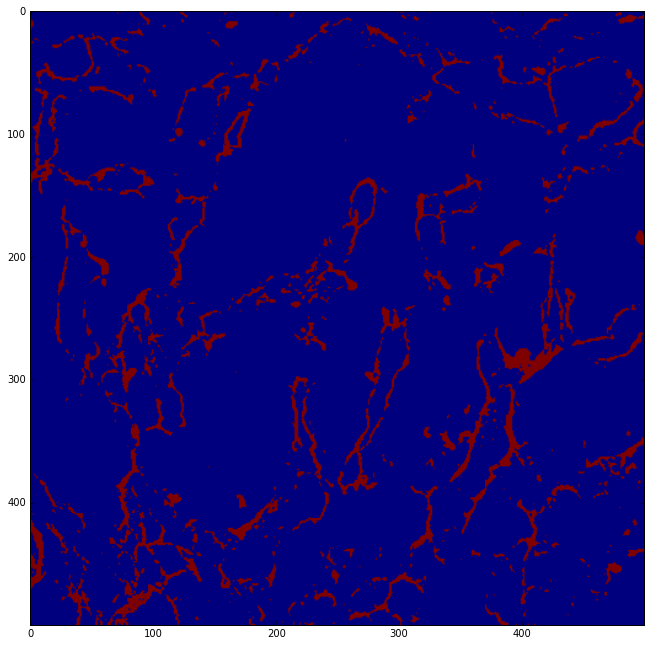

In [72]:
plt.figure(figsize=(16,11))
plt.imshow(imthr[view])

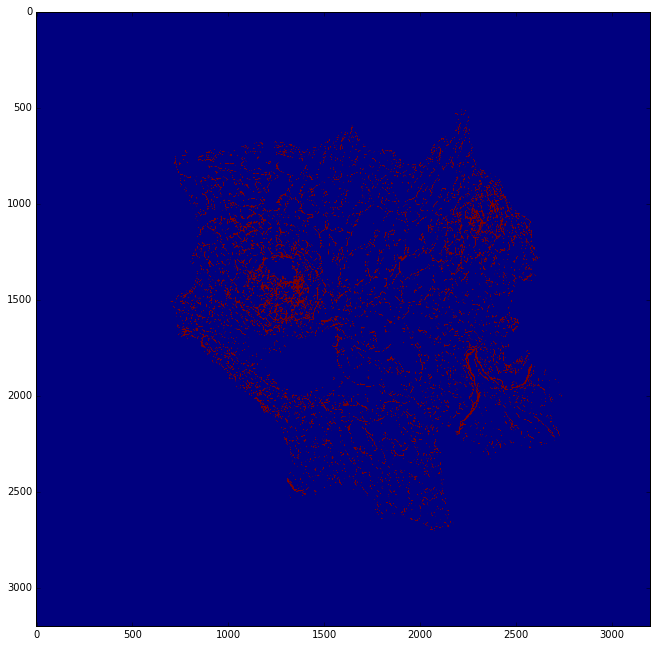

In [42]:
plt.figure(figsize=(16,11))
plt.imshow(imthr)

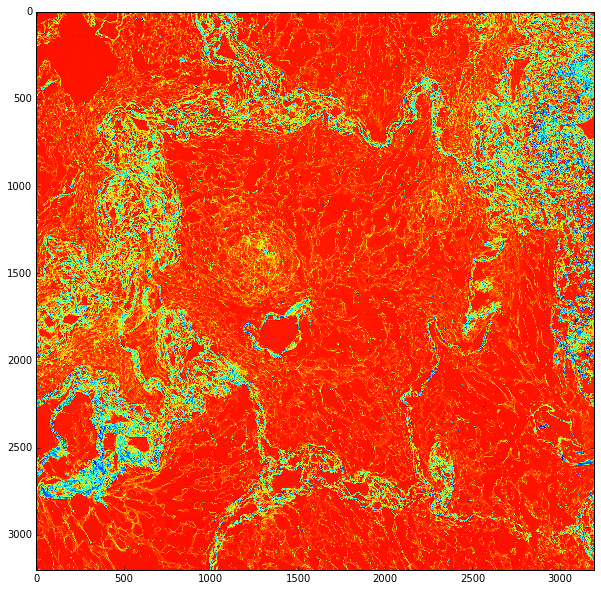

In [73]:

image = newimgr#[view]
plt.figure(figsize(15, 10))
plt.imshow(image)

## Skeletonization

C:\Users\miros\Miniconda3\envs\lisa36\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.minimum.reduce will be axis=0, not the current None, to match np.minimum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)
C:\Users\miros\Miniconda3\envs\lisa36\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.maximum.reduce will be axis=0, not the current None, to match np.maximum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)


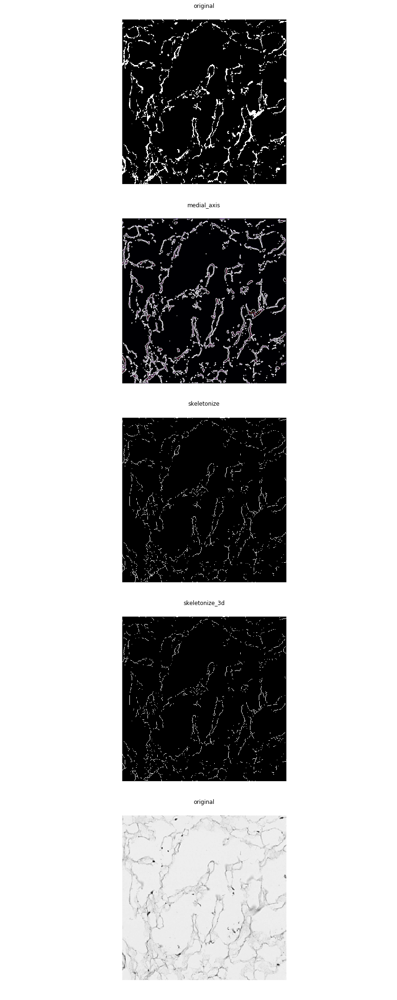

In [76]:
from skimage.morphology import medial_axis, skeletonize, skeletonize_3d

data = imthr[view]

# Compute the medial axis (skeleton) and the distance transform
skel, distance = medial_axis(data, return_distance=True)

# Compare with other skeletonization algorithms
skeleton = skeletonize(data)
skeleton3d = skeletonize_3d(data)

# Distance to the background for pixels of the skeleton
dist_on_skel = distance * skel

fig, axes = plt.subplots(5, 1, figsize=(12, 30), sharex=True, sharey=True)
ax = axes.ravel()

ax[4].imshow(newimgr[view], cmap=plt.cm.gray, interpolation='nearest')
ax[4].set_title('original')
ax[4].axis('off')

ax[0].imshow(data, cmap=plt.cm.gray, interpolation='nearest')
ax[0].set_title('original')
ax[0].axis('off')

ax[1].imshow(dist_on_skel, cmap='magma', interpolation='nearest')
ax[1].contour(data, [0.5], colors='w')
ax[1].set_title('medial_axis')
ax[1].axis('off')

ax[2].imshow(skeleton, cmap=plt.cm.gray, interpolation='nearest')
ax[2].set_title('skeletonize')
ax[2].axis('off')

ax[3].imshow(skeleton3d, cmap=plt.cm.gray, interpolation='nearest')
ax[3].set_title('skeletonize_3d')
ax[3].axis('off')

fig.tight_layout()
plt.show()

## Texture analysis

In [45]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import local_binary_pattern

METHOD = 'uniform'
plt.rcParams['font.size'] = 9



### LBP

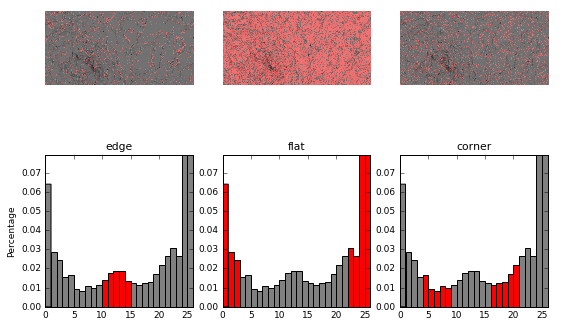

In [46]:
from skimage.transform import rotate
from skimage.feature import local_binary_pattern
from skimage import data
from skimage.color import label2rgb

# settings for LBP
radius = 3
n_points = 8 * radius


def overlay_labels(image, lbp, labels):
    mask = np.logical_or.reduce([lbp == each for each in labels])
    return label2rgb(mask, image=image, bg_label=0, alpha=0.5)


def highlight_bars(bars, indexes):
    for i in indexes:
        bars[i].set_facecolor('r')


# image = data.load('brick.png')
image = newimgr[view]
lbp = local_binary_pattern(image, n_points, radius, METHOD)


def hist(ax, lbp):
    n_bins = int(lbp.max() + 1)
    return ax.hist(lbp.ravel(), normed=True, bins=n_bins, range=(0, n_bins),
                   facecolor='0.5')


# plot histograms of LBP of textures
fig, (ax_img, ax_hist) = plt.subplots(nrows=2, ncols=3, figsize=(9, 6))
plt.gray()

titles = ('edge', 'flat', 'corner')
w = width = radius - 1
edge_labels = range(n_points // 2 - w, n_points // 2 + w + 1)
flat_labels = list(range(0, w + 1)) + list(range(n_points - w, n_points + 2))
i_14 = n_points // 4            # 1/4th of the histogram
i_34 = 3 * (n_points // 4)      # 3/4th of the histogram
corner_labels = (list(range(i_14 - w, i_14 + w + 1)) +
                 list(range(i_34 - w, i_34 + w + 1)))

label_sets = (edge_labels, flat_labels, corner_labels)

for ax, labels in zip(ax_img, label_sets):
    ax.imshow(overlay_labels(image, lbp, labels))

for ax, labels, name in zip(ax_hist, label_sets, titles):
    counts, _, bars = hist(ax, lbp)
    highlight_bars(bars, labels)
    ax.set_ylim(ymax=np.max(counts[:-1]))
    ax.set_xlim(xmax=n_points + 2)
    ax.set_title(name)

ax_hist[0].set_ylabel('Percentage')
for ax in ax_img:
    ax.axis('off')

Rotated images matched against references using LBP:
original: sample0, rotated: 30deg, match result:  sample0
original: sample1, rotated: 70deg, match result:  sample0
original: sample2, rotated: 145deg, match result:  sample0


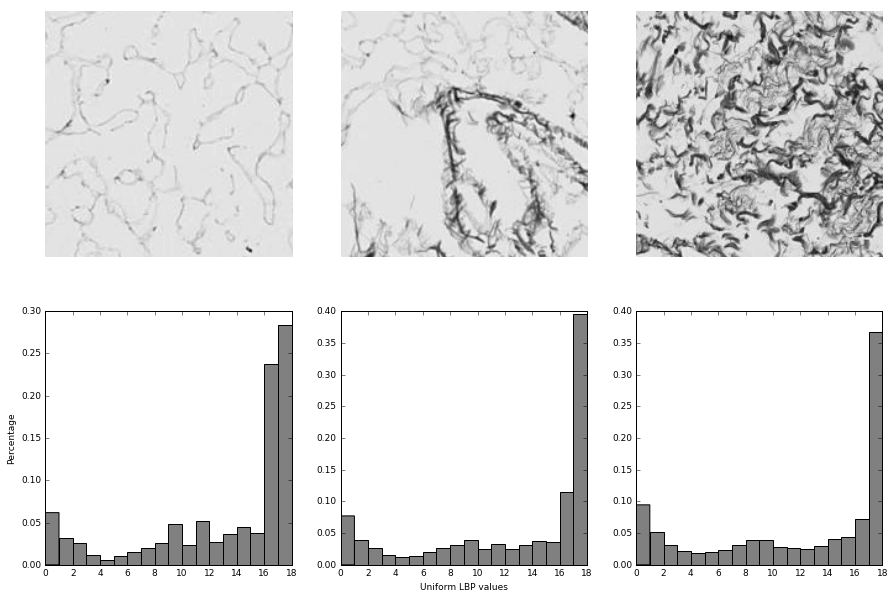

In [47]:
# settings for LBP
radius = 2
n_points = 8 * radius


def kullback_leibler_divergence(p, q):
    p = np.asarray(p)
    q = np.asarray(q)
    filt = np.logical_and(p != 0, q != 0)
    return np.sum(p[filt] * np.log2(p[filt] / q[filt]))


def match(refs, img):
    best_score = 10
    best_name = None
    lbp = local_binary_pattern(img, n_points, radius, METHOD)
    n_bins = int(lbp.max() + 1)
    hist, _ = np.histogram(lbp, density=True, bins=n_bins, range=(0, n_bins))
    for name, ref in refs.items():
        ref_hist, _ = np.histogram(ref, density=True, bins=n_bins,
                                   range=(0, n_bins))
        score = kullback_leibler_divergence(hist, ref_hist)
        if score < best_score:
            best_score = score
            best_name = name
    return best_name


sample0 = skimage.color.rgb2gray(np.asarray(imsl.read_region(**kwargs_sample0)))
sample1 = skimage.color.rgb2gray(np.asarray(imsl.read_region(**kwargs_sample1)))
sample2 = skimage.color.rgb2gray(np.asarray(imsl.read_region(**kwargs_sample2)))
# brick = data.load('brick.png')
# grass = data.load('grass.png')
# wall = data.load('rough-wall.png')

refs = {
    'sample0': local_binary_pattern(sample0, n_points, radius, METHOD),
    'sample1': local_binary_pattern(sample1, n_points, radius, METHOD),
    'sample2': local_binary_pattern(sample2, n_points, radius, METHOD)
}

# classify rotated textures
print('Rotated images matched against references using LBP:')
print('original: sample0, rotated: 30deg, match result: ',
      match(refs, rotate(sample0, angle=30, resize=False)))
print('original: sample1, rotated: 70deg, match result: ',
      match(refs, rotate(sample1, angle=70, resize=False)))
print('original: sample2, rotated: 145deg, match result: ',
      match(refs, rotate(sample2, angle=145, resize=False)))

# plot histograms of LBP of textures
fig, ((ax1, ax2, ax3), (ax4, ax5, ax6)) = plt.subplots(nrows=2, ncols=3,
                                                       figsize=(15, 10))
plt.gray()

ax1.imshow(sample0)
ax1.axis('off')
hist(ax4, refs['sample0'])
ax4.set_ylabel('Percentage')

ax2.imshow(sample1)
ax2.axis('off')
hist(ax5, refs['sample1'])
ax5.set_xlabel('Uniform LBP values')

ax3.imshow(sample2)
ax3.axis('off')
hist(ax6, refs['sample2'])

plt.show()

In [48]:
def texture_segmentation(image, decision_function, models, tile_size):
    output = np.asarray(image, dtype=np.int8)
    for x0 in range(0, image.shape[0], tile_size[0]):
        for x1 in range(0, image.shape[1], tile_size[1]):
            sl = [
                slice(x0, x0 + tile_size[0]),
                slice(x1, x1 + tile_size[1])
            ]
            output[sl] = decision_function(models, image[sl])
            
    return output
            
    

In [57]:
sample0 = skimage.color.rgb2gray(np.asarray(imsl.read_region(**kwargs_sample0)))
sample1 = skimage.color.rgb2gray(np.asarray(imsl.read_region(**kwargs_sample1)))
sample2 = skimage.color.rgb2gray(np.asarray(imsl.read_region(**kwargs_sample2)))
sample_bigger = skimage.color.rgb2gray(np.asarray(imsl.read_region(**kwargs_sample_bigger)))
# brick = data.load('brick.png')
# grass = data.load('grass.png')
# wall = data.load('rough-wall.png')

models = {
    1: local_binary_pattern(sample0, n_points, radius, METHOD),
#     2: local_binary_pattern(sample1, n_points, radius, METHOD),
    3: local_binary_pattern(sample2, n_points, radius, METHOD)
}

C:\Users\miros\Miniconda3\envs\lisa36\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.minimum.reduce will be axis=0, not the current None, to match np.minimum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)
C:\Users\miros\Miniconda3\envs\lisa36\lib\site-packages\numpy\ma\core.py:6385: MaskedArrayFutureWarning: In the future the default for ma.maximum.reduce will be axis=0, not the current None, to match np.maximum.reduce. Explicitly pass 0 or None to silence this warning.
  return self.reduce(a)


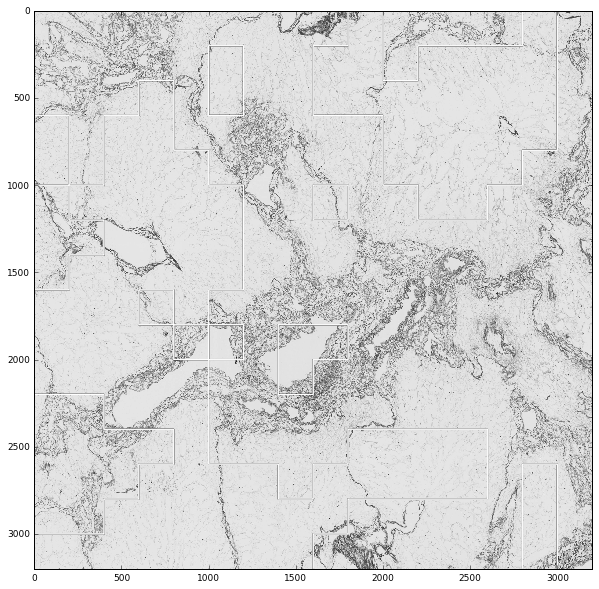

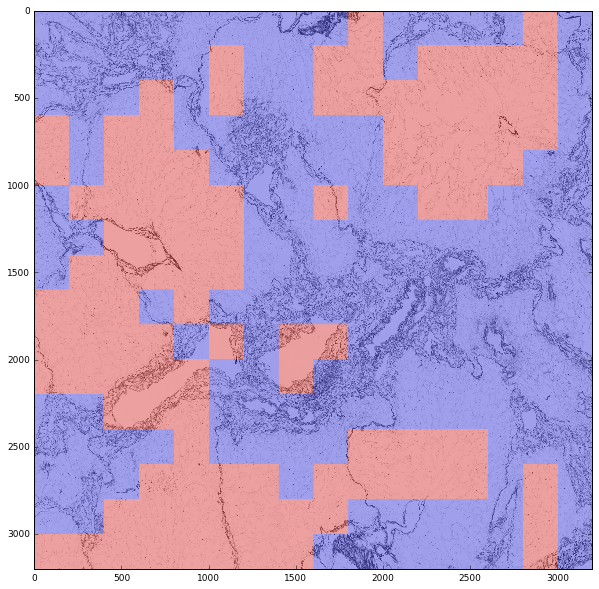

In [64]:
seg = texture_segmentation(sample_bigger, match, models, kwargs_sample0["size"])
figure()
imshow(sample_bigger)
contour(seg)
import skimage.color
figure()
imshow(skimage.color.label2rgb(seg, sample_bigger))

In [59]:
import skimage.morphology
# help(skimage.morphology.label)
skimage

Help on function label in module skimage.measure._label:

label(input, neighbors=None, background=None, return_num=False, connectivity=None)
    Label connected regions of an integer array.
    
    Two pixels are connected when they are neighbors and have the same value.
    In 2D, they can be neighbors either in a 1- or 2-connected sense.
    The value refers to the maximum number of orthogonal hops to consider a
    pixel/voxel a neighbor::
    
      1-connectivity      2-connectivity     diagonal connection close-up
    
           [ ]           [ ]  [ ]  [ ]         [ ]
            |               \  |  /             |  <- hop 2
      [ ]--[x]--[ ]      [ ]--[x]--[ ]    [x]--[ ]
            |               /  |  \         hop 1
           [ ]           [ ]  [ ]  [ ]
    
    Parameters
    ----------
    input : ndarray of dtype int
        Image to label.
    neighbors : {4, 8}, int, optional
        Whether to use 4- or 8-"connectivity".
        In 3D, 4-"connectivity" means co

In [51]:
meshgrid([1,5,10], [1,5,10])

[array([[ 1,  5, 10],
        [ 1,  5, 10],
        [ 1,  5, 10]]), array([[ 1,  1,  1],
        [ 5,  5,  5],
        [10, 10, 10]])]

# Read annotation from json

In [8]:
def read_annotations(pth):
    fn = pth + ".ndpa.json"
    with open(fn) as f:
        data = json.load(f)
    return data

In [9]:
annotations = read_annotations(pth)
len(annotations)

12

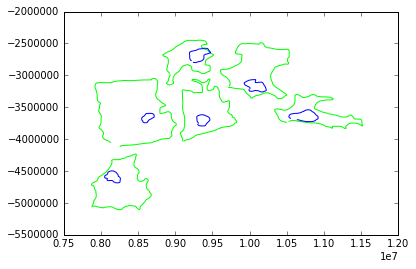

In [10]:
def plot_annotations(annotations):
    for annotation in annotations:
        plt.hold(True)
        plt.plot(annotation["x"], annotation["y"], c=annotation["color"])
plot_annotations(annotations)

# Combine image data with annotation

In [6]:
import pandas as pd
df = pd.DataFrame(annotations[0])
location0 = (df.x.min(), -df.y.max())
location0

NameError: name 'annotations' is not defined

In [7]:
level = 6
display(imsl.level_dimensions)
imcr = imsl.read_region(location0, level ,(1000,1000))
imcr

((57344, 44800),
 (28672, 22400),
 (14336, 11200),
 (7168, 5600),
 (3584, 2800),
 (1792, 1400),
 (896, 700),
 (448, 350),
 (224, 175))

NameError: name 'location0' is not defined